<a href="https://colab.research.google.com/github/gt23delhi/Pix2Pix_GAN/blob/main/Pix2Pix_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install tensorflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.9/644.9 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57.5 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.5/24.5 MB 88.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 319.9/319.9 kB 24.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 126.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 120.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 123.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 18.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.5/72.5 kB 6.6 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 6.31.1
    Uninstalling protobuf-6.31.1:
      Successfully uninstalled protobuf-6.31.1


Files extracted

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import os
from pathlib import Path
import pickle
from tensorflow.keras.layers import Input, Conv2D, LeakyReLU, Dropout, Concatenate, Conv2DTranspose, BatchNormalization, Activation
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.initializers import RandomNormal

from tensorflow.keras.utils import plot_model

import pathlib
import time
import datetime
from IPython import display

In [2]:
def separate_images(dataset_path, location_extracted_files):
    """
    Separates composite dataset images into satellite and map images.

    Args:
        train_path (str): Path to the directory containing composite images.

    Returns:
        tuple: Two numpy arrays containing satellite and map images.
    """
    source_satellite = []
    target_map = []

    for img in os.listdir(dataset_path):
        composite_image = tf.keras.utils.load_img(os.path.join(dataset_path, img))  # Load image
        composite_image = tf.keras.utils.img_to_array(composite_image)  # Convert to array
        #composite_image = tf.image.convert_image_dtype(composite_image, dtype=tf.float32)

        # width of image 1200 pixels
        satellite_image = composite_image[:, :600, :]  # Satellite image is on the left
        map_image = composite_image[:, 600:, :]  # Map image is on the right

        # Resize images to 256x256
        satellite_image = tf.image.resize(satellite_image, (256, 256))
        map_image = tf.image.resize(map_image, (256, 256))

        source_satellite.append(satellite_image)
        target_map.append(map_image)

    return np.array(source_satellite), np.array(target_map)

In [3]:
output_dir = '/content/drive/MyDrive/Colab Notebooks/BME_Projects/map_data_gan/extracted_maps'

# Define the path to the extracted test data in Google Drive
extracted_test_data_path = '/content/drive/MyDrive/Colab Notebooks/BME_Projects/map_data_gan/maps/val'

In [4]:
extracted_test_data_path

'/content/drive/MyDrive/Colab Notebooks/BME_Projects/map_data_gan/maps/val'

In [5]:

#val_satellite, val_maps = separate_images(extracted_test_data_path, output_dir)

# Save the images as numpy arrays using pickle
#with open(os.path.join(output_dir, 'val_source_satellite_images.pkl'), 'wb') as f:
#    pickle.dump(val_satellite, f)

#with open(os.path.join(output_dir, 'val_target_map_images.pkl'), 'wb') as f:
#    pickle.dump(val_maps, f)

#print(f"Separated images saved to {output_dir}")

In [6]:
# 70 X 70 patchgan discriminator model
def build_discriminator(input_shape=(256, 256, 3)):
    """
    Builds a PatchGAN discriminator model.

    Args:
        input_shape (tuple): Shape of the input images.

    Returns:
        keras.Model: The 70 X 70 PatchGAN discriminator model.
    """
    #inputs = Input(shape=input_shape)
    weights_gaussian = tf.random_normal_initializer(mean=0.0, stddev=0.02)
    inp = Input(shape=input_shape, name='input_satellite_image')
    tar = Input(shape=input_shape, name='target_map_image')

    merged_input= Concatenate()([inp, tar])  # Concatenate satellite and map images

    # Layer 1
    x = Conv2D(64, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_gaussian)(merged_input)
    x = LeakyReLU(alpha=0.2)(x)

    # Layer 2
    x = Conv2D(128, kernel_size=4, strides=2, padding='same',kernel_initializer=weights_gaussian)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    # Layer 3
    x = Conv2D(256, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_gaussian)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    # Layer 4
    x = Conv2D(512, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_gaussian)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    # (second-last layer)
    x = Conv2D(512, kernel_size=4, padding='same', kernel_initializer=weights_gaussian)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    # Output layer
    last_layer = Conv2D(1, kernel_size=4, padding='same', kernel_initializer=weights_gaussian, activation='sigmoid')(x)

    model = Model(inputs=[inp,tar], outputs=last_layer, name='discriminator')

    # Compile the model
    model.compile(optimizer=Adam(2e-4, beta_1=0.5), loss='binary_crossentropy',loss_weights=[0.5])

    return model


### U-NET Generator Model

  - The Encoder block contains Convolution-Batchnorm-LeakyRelu.
  - The Decoder block contains Convolution-Batchnorm-DropOut-Relu.
  - filter size 4X4, stride of 2.

In [7]:
def enc_block(inp_layers, number_of_filters, apply_batchnorm=True):
    """
    Creates an encoder block for the UNET architecture.

    Args:
        inp_layers (keras.layers.Layer): Input layer for the block.
        number_of_filters (int): Number of filters for the convolutional layer.
        apply_batchnorm (bool): Whether to apply batch normalization.

    Returns:
        keras.layers.Layer: Encoder block model.
    """
    weights_gaussian = tf.keras.initializers.RandomNormal(mean=0.0,stddev=0.02)
    # downsampling layer
    x = Conv2D(number_of_filters, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_gaussian)(inp_layers)
    if apply_batchnorm:
        x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)
    return x

In [8]:
# Decoder block
def dec_block(inp_layers,skip_connection, number_of_filters, apply_dropout=True):
    """
    Creates a decoder block for the UNET architecture.

    Args:
        inp_layers (keras.layers.Layer): Input layer for the block.
        number_of_filters (int): Number of filters for the convolutional layer.
        skip_connection (keras.layers.Layer): Skip connection from the encoder block.
        apply_dropout (bool): Whether to apply dropout in the block.

    Returns:
        keras.layers.Layer: Decoder block model.
    """
    weights_gaussian = tf.keras.initializers.RandomNormal(stddev=0.02)
    # upsampling layer
    x = Conv2DTranspose(number_of_filters, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_gaussian)(inp_layers)
    x = BatchNormalization()(x, training=True)  # Use training=True for batch normalization
    # apply dropout if specified
    if apply_dropout:
        x = Dropout(0.5)(x, training=True)  # Use training=True for dropout
    # Concatenate the upsampled layer with the skip connection
    x = Concatenate()([x, skip_connection])
    x = Activation('relu')(x)
    return x

In [9]:
# Generator model
def build_generator(input_shape=(256, 256, 3)):
    """
    Builds a U-Net generator model.

    Args:
        input_shape (tuple): Shape of the input images.

    Returns:
        keras.Model: The generator model.
    """
    input_image = Input(shape=input_shape)
    weights_gaussian = tf.keras.initializers.RandomNormal(mean=0.0,stddev=0.02)
    # Encoder
    e1 = enc_block(input_image, 64, apply_batchnorm=False)  # No batch norm on first layer
    e2 = enc_block(e1, 128)
    e3 = enc_block(e2, 256)
    e4 = enc_block(e3, 512)
    e5 = enc_block(e4, 512)
    e6 = enc_block(e5, 512)
    e7 = enc_block(e6, 512)
    #e8 = enc_block(e7, 512)
    # Bottleneck, no batchnorma and relu
    #b = enc_block(e7, 512)
    bottleneck = Conv2D(512, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_gaussian)(e7)
    bottleneck= Activation('relu')(bottleneck)

    # Decoder

    d1 = dec_block(bottleneck,  e7, 512)
    d2 = dec_block(d1, e6, 512)
    d3 = dec_block(d2, e5, 512)
    d4 = dec_block(d3, e4, 512,apply_dropout=False)
    d5 = dec_block(d4, e3, 256,apply_dropout=False)
    d6 = dec_block(d5, e2, 128,apply_dropout=False)
    d7 = dec_block(d6, e1, 64,apply_dropout=False)


    # Output layer
    outputs = Conv2DTranspose(3, kernel_size=4, strides=2, padding='same', activation='tanh')(d7)

    model = Model(inputs=input_image, outputs=outputs, name='generator')

    return model

In [10]:
def combined_model(generator, discriminator, image_shape):
    """
    Creates a combined model for training the generator.

    Args:
        generator (keras.Model): The generator model.
        discriminator (keras.Model): The discriminator model.
        image_shape (tuple): Shape of the input images.

    Returns:
        keras.Model: The combined model.
    """
    input_image = Input(shape=image_shape, name='input_satellite_image')   # (256, 256, 3)
    generated_map = generator(input_image)

    # Freeze the discriminator during generator training
    for layer in discriminator.layers:
        if not isinstance(layer, layers.BatchNormalization):
            layer.trainable = False
    disc_output = discriminator([input_image, generated_map])

    # Create optimizers
    optimizer = Adam(2e-4, beta_1=0.5)

    composite_model = Model(inputs=input_image, outputs=[generated_map, disc_output], name='combined_model')
    composite_model.compile(optimizer=optimizer,
                          loss=['mae', 'binary_crossentropy'],
                          loss_weights=[100, 1]) # L1 loss weighted more than adversarial loss

    return composite_model

In [11]:
generated_images_dir = '/content/drive/MyDrive/Colab Notebooks/BME_Projects/map_data_gan/extracted_maps'

In [12]:

def generate_and_save_images(generator_model, satellite_images_val, map_images_val, output_dir='generated_images_dir'):
    """
    Generates and saves images using the generator_model model.

    Args:
        generator_model (keras.Model): The generator_model model.
        satellite_images_val (np.ndarray): Array of Validation satellite images.
        map_images_val (np.ndarray): Array of map images for testing.
        output_dir (str): Directory to save the generated images.
    """

    num_samples= 3
    idx= np.random.choice(len(satellite_images_val), num_samples, replace=False)
    sample_sat_val = satellite_images_val[idx]
    sample_target_val = map_images_val[idx]
    sample_generated_map = generator_model.predict(satellite_images_val)

    # scale pixels from [-1,1] to [0,1]
    sample_sat_val = (sample_sat_val + 1) / 2.0
    sample_target_val = (sample_target_val + 1) / 2.0
    sample_generated_map = (sample_generated_map + 1) / 2.0

    title = ['Input Image', 'Ground Truth', 'Predicted Map']
    plt.figure(figsize=(10, num_samples * 3))
    for i in range(num_samples):
        # Display the input satellite image
        plt.subplot(num_samples, 3, i * 3 + 1)
        display_image = sample_sat_val[i]
        plt.imshow(display_image)
        plt.title(title[0])
        plt.axis('off')

        # Display the ground truth map
        plt.subplot(num_samples, 3, i * 3 + 2)
        display_image = sample_target_val[i]
        plt.imshow(display_image)
        plt.title(title[1])
        plt.axis('off')

        # Display the generated map
        plt.subplot(num_samples, 3, i * 3 + 3)
        display_image = sample_generated_map[i]
        plt.imshow(display_image)
        plt.title(title[2])
        plt.axis('off')
        plt.tight_layout()
        plt.show()
        plt.savefig(os.path.join(output_dir, 'generated_image.png'))
        plt.close()

In [13]:
# Generator save location
models_direc = '/content/drive/MyDrive/Colab Notebooks/BME_Projects/map_data_gan/models_saved'

In [ ]:
# Training loop for Pix2Pix GAN
def train_on_batch(generator_model, discriminator_model, gan_model,source_satellite, source_maps,source_satellite_test, source_maps_test,):
    """
    Trains the Pix2Pix GAN on a single batch of data.

    Args:
        generator_model (keras.Model): The generator_model model.
        discriminator_model (keras.Model): The discriminator_model model.
        source_satellite (np.ndarray): Array of satellite training images.
        source_maps (np.ndarray): Array of map training images.
        source_satellite_test (np.ndarray): Array of test satellite images.
        source_maps_test (np.ndarray): Array of test map images.

    Returns:
        tuple: Losses for the generator_model and discriminator_model.
    """

    epochs = 100
    batch_size = 1
    lambda_weight = 100

    for epoch in range(epochs):
        print(f"Epoch {epoch+1}/{epochs}")
        num_batches = len(source_satellite) // batch_size
        for batch in range(num_batches):
            # select a random batch of images
            idx = np.random.randint(0, len(source_satellite), batch_size)
            real_satellite = source_satellite[idx]
            real_maps = source_maps[idx]

            # compute discriminator_model loss
            disc_real_loss = discriminator_model.train_on_batch([real_satellite, real_maps], tf.ones((batch_size, 16, 16, 1)))
            fake_maps = generator_model.predict(real_satellite)
            disc_fake_loss = discriminator_model.train_on_batch([real_satellite, fake_maps], tf.zeros((batch_size, 16, 16, 1)))

            # compute generator_model loss
            gener_loss,_ , _ = gan_model.train_on_batch(real_satellite, [fake_maps, tf.ones((batch_size, 16, 16, 1))])

            # summarize performance
            if (batch + 1) % 500 == 0:
                generate_and_save_images(generator_model, source_satellite_test, source_maps_test, output_dir= generated_images_dir)
            print(f"Batch {batch+1}/{num_batches}, D Real_Loss: {disc_real_loss:.4f}, D Fake_Loss: {disc_fake_loss:.4f} , G total_Loss: {gener_loss:.4f}")
            # Save the generator model when epochs are multiples of 10 and batch is a multiple of 500
            if (epoch + 1) % 10 == 0 and (batch + 1) % 500 == 0:
                generator_model.save(os.path.join(models_direc, f'generator_model_epoch{epoch}_batch{batch}.keras'))


    print("Training complete.")



In [14]:
def load_data(prepared_imgs):
    """
    Loads the training and validation data for the Pix2Pix GAN.

    Returns:
        tuple: Arrays of source satellite images, source maps, source satellite test images, and source maps test images.
    """
    # Load the data from the specified paths


    import pickle
    with open(os.path.join(prepared_imgs, 'source_satellite_images_train.pkl'), 'rb') as f:
        train_sat = pickle.load(f)
        source_satellite = train_sat
    # source_satellite = np.load(os.path.join(train_path, 'source_satellite.npy'))
    with open(os.path.join(prepared_imgs, 'target_map_images_train.pkl'), 'rb') as f:
        train_map_split = pickle.load(f)
        source_maps = train_map_split

    # source_maps = np.load(os.path.join(train_path, 'source_maps.npy'))
    with open(os.path.join(prepared_imgs, 'val_source_satellite_images.pkl'), 'rb') as f:
        val_satellite = pickle.load(f)
        source_satellite_test = val_satellite

    # source_satellite_test = np.load(os.path.join(test_path, 'source_satellite_test.npy'))

    with open(os.path.join(output_dir, 'val_target_map_images.pkl'), 'rb') as f:
        val_maps = pickle.load(f)
        source_maps_test = val_maps

    # print shapes
    # print("Source Satellite Shape:", source_satellite.shape)
    # print("Source Maps Shape:", source_maps.shape)
    # print("Source Satellite Test Shape:", source_satellite_test.shape)
    # print("Source Maps Test Shape:", source_maps_test.shape)
    img_shape = source_satellite.shape[1:]  # Get the shape of the images

    # scale from [0,255] to [-1,1]
    source_satellite = (source_satellite / 127.5) - 1.0
    source_maps = (source_maps / 127.5) - 1.0
    source_satellite_test = (source_satellite_test / 127.5) - 1.0
    source_maps_test = (source_maps_test / 127.5) - 1.0
    # print("Source Satellite Shape:", source_satellite.shape)
    # print("Source Maps Shape:", source_maps.shape)
    # print("Source Satellite Test Shape:", source_satellite_test.shape)
    # print("Source Maps Test Shape:", source_maps_test.shape)


    return source_satellite, source_maps, source_satellite_test, source_maps_test, img_shape


In [15]:
sat_train, maps_train, val_sat,val_map ,input_shape = load_data(output_dir)

In [16]:
sat_train.shape

(1096, 256, 256, 3)

In [17]:
input_shape

(256, 256, 3)

In [18]:
val_map.shape, val_sat.shape

((1098, 256, 256, 3), (1098, 256, 256, 3))

In [19]:

# Build and compile models
generator_model = build_generator()
discriminator_model = build_discriminator()
gan_model = combined_model(generator_model, discriminator_model, input_shape)
# discriminator_model.summary()
# generator_model.summary()
# plot_model(generator_model, to_file=os.path.join(check_path, 'generator_model.png'), show_shapes=True, show_layer_names=True)
# plot_model(gan_model, to_file=os.path.join(check_path, 'gan_model.png'), show_shapes=True, show_layer_names=True)
# plot_model(discriminator_model, to_file=os.path.join(check_path, 'discriminator_model.png'), show_shapes=True, show_layer_names=True)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Epoch 1/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
Batch 1/1096, D Real_Loss: 0.5089, D Fake_Loss: 0.4247 , G total_Loss: 25.8918
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
Batch 2/1096, D Real_Loss: 0.4558, D Fake_Loss: 0.4228 , G total_Loss: 24.6016
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Batch 3/1096, D Real_Loss: 0.4420, D Fake_Loss: 0.4237 , G total_Loss: 23.4987
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Batch 4/1096, D Real_Loss: 0.4358, D Fake_Loss: 0.4220 , G total_Loss: 22.2216
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
Batch 5/1096, D Real_Loss: 0.4319, D Fake_Loss: 0.4225 , G total_Loss: 21.2665
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Batch 6/1096, D Real_Loss: 0.4321, D Fake_Loss: 0.4250 , G total_Loss: 20.1331
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 7/1096, D Real_Loss: 0.4317, D Fake_Loss: 0.4242 , G total_Loss: 19.1464
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Batch 8/1096, D Real_Loss: 0.4295, D Fake_Loss: 0.4238 , G total_Loss: 18.0619
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
Batch 9/1096, D 

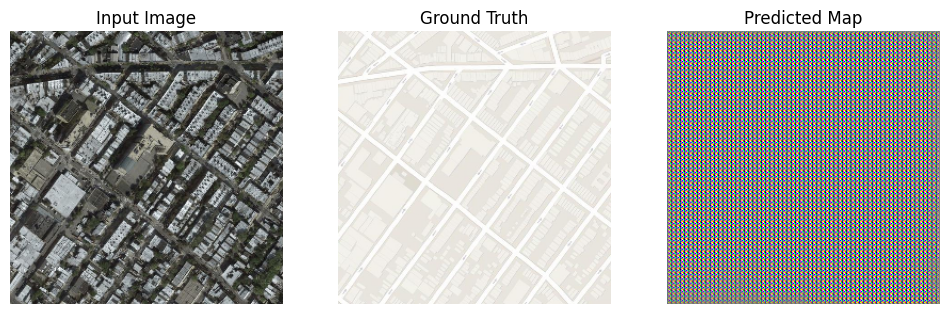

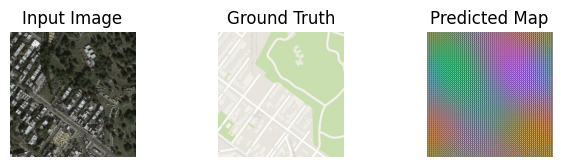

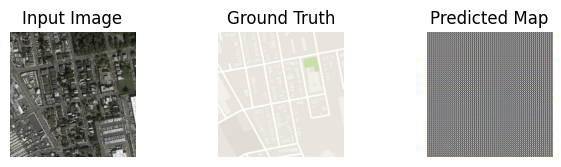

Batch 500/1096, D Real_Loss: 0.4247, D Fake_Loss: 0.4250 , G total_Loss: 3.9396
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 501/1096, D Real_Loss: 0.4248, D Fake_Loss: 0.4250 , G total_Loss: 3.9392
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
Batch 502/1096, D Real_Loss: 0.4248, D Fake_Loss: 0.4250 , G total_Loss: 3.9383
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Batch 503/1096, D Real_Loss: 0.4248, D Fake_Loss: 0.4251 , G total_Loss: 3.9357
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Batch 504/1096, D Real_Loss: 0.4249, D Fake_Loss: 0.4251 , G total_Loss: 3.9352
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Batch 505/1096, D Real_Loss: 0.4249, D Fake_Loss: 0.4251 , G total_Loss: 3.9315
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Batch 506/1096, D Real_Loss: 0.4249, D Fake_Loss: 0.4252 , G total_Loss: 3.9284
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Batch 507/1096, D Real_Loss: 0.4250, D Fake_Loss: 0.4252 , G total_Loss: 3.9273
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
Batch 508/1096, D Real_Loss: 0.4250, D Fake_Loss: 0.4252

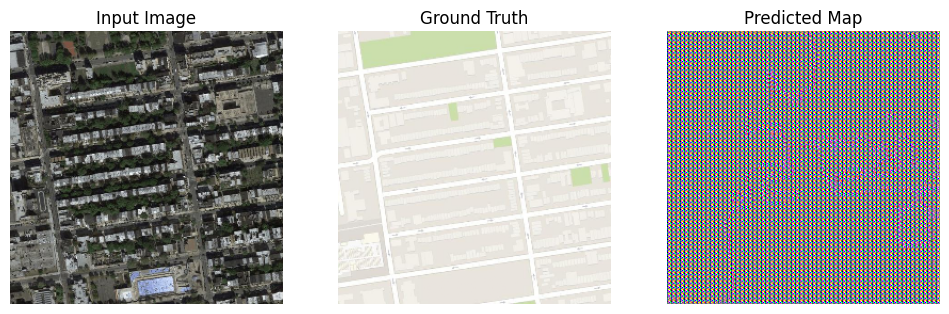

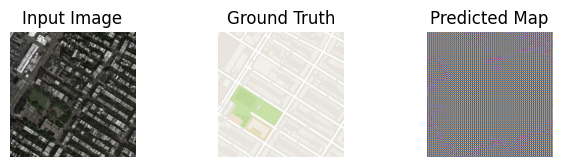

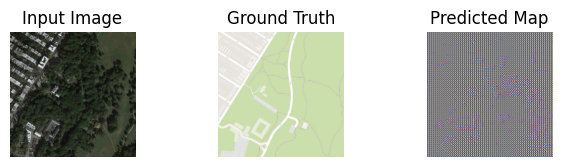

Batch 1000/1096, D Real_Loss: 0.4346, D Fake_Loss: 0.4347 , G total_Loss: 4.0057
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
Batch 1001/1096, D Real_Loss: 0.4346, D Fake_Loss: 0.4347 , G total_Loss: 4.0412
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Batch 1002/1096, D Real_Loss: 0.4346, D Fake_Loss: 0.4347 , G total_Loss: 4.0572
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
Batch 1003/1096, D Real_Loss: 0.4346, D Fake_Loss: 0.4347 , G total_Loss: 4.0916
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Batch 1004/1096, D Real_Loss: 0.4346, D Fake_Loss: 0.4347 , G total_Loss: 4.1256
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Batch 1005/1096, D Real_Loss: 0.4346, D Fake_Loss: 0.4347 , G total_Loss: 4.1538
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Batch 1006/1096, D Real_Loss: 0.4346, D Fake_Loss: 0.4348 , G total_Loss: 4.1843
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Batch 1007/1096, D Real_Loss: 0.4346, D Fake_Loss: 0.4348 , G total_Loss: 4.2323
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 1008/1096, D Real_Loss: 0.4346, D Fake_Los

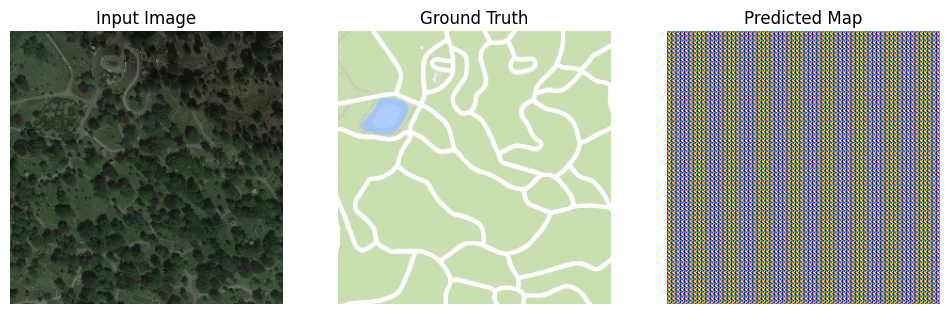

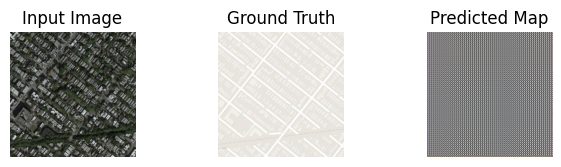

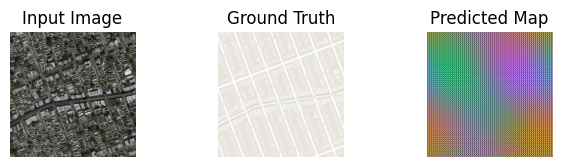

Batch 500/1096, D Real_Loss: 0.4398, D Fake_Loss: 0.4398 , G total_Loss: 3.0972
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
Batch 501/1096, D Real_Loss: 0.4398, D Fake_Loss: 0.4399 , G total_Loss: 3.0955
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
Batch 502/1096, D Real_Loss: 0.4398, D Fake_Loss: 0.4399 , G total_Loss: 3.0939
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 503/1096, D Real_Loss: 0.4398, D Fake_Loss: 0.4399 , G total_Loss: 3.0922
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
Batch 504/1096, D Real_Loss: 0.4398, D Fake_Loss: 0.4399 , G total_Loss: 3.0905
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
Batch 505/1096, D Real_Loss: 0.4398, D Fake_Loss: 0.4399 , G total_Loss: 3.0889
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 506/1096, D Real_Loss: 0.4398, D Fake_Loss: 0.4399 , G total_Loss: 3.0872
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Batch 507/1096, D Real_Loss: 0.4398, D Fake_Loss: 0.4399 , G total_Loss: 3.0856
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
Batch 508/1096, D Real_Loss: 0.4398, D Fake_Loss: 0.4399

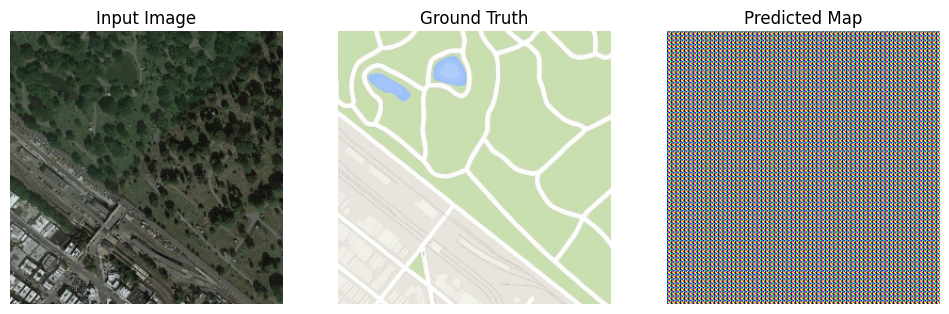

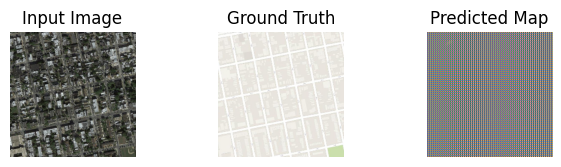

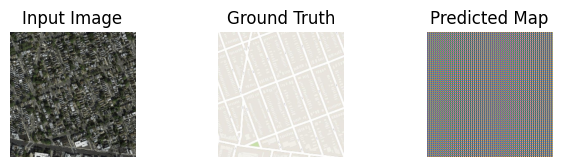

Batch 1000/1096, D Real_Loss: 0.4419, D Fake_Loss: 0.4420 , G total_Loss: 3.2861
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
Batch 1001/1096, D Real_Loss: 0.4420, D Fake_Loss: 0.4420 , G total_Loss: 3.2848
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
Batch 1002/1096, D Real_Loss: 0.4420, D Fake_Loss: 0.4420 , G total_Loss: 3.2840
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Batch 1003/1096, D Real_Loss: 0.4420, D Fake_Loss: 0.4420 , G total_Loss: 3.2829
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Batch 1004/1096, D Real_Loss: 0.4420, D Fake_Loss: 0.4420 , G total_Loss: 3.2816
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Batch 1005/1096, D Real_Loss: 0.4420, D Fake_Loss: 0.4420 , G total_Loss: 3.2803
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 1006/1096, D Real_Loss: 0.4420, D Fake_Loss: 0.4420 , G total_Loss: 3.2792
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
Batch 1007/1096, D Real_Loss: 0.4420, D Fake_Loss: 0.4420 , G total_Loss: 3.2779
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
Batch 1008/1096, D Real_Loss: 0.4420, D Fake_Los

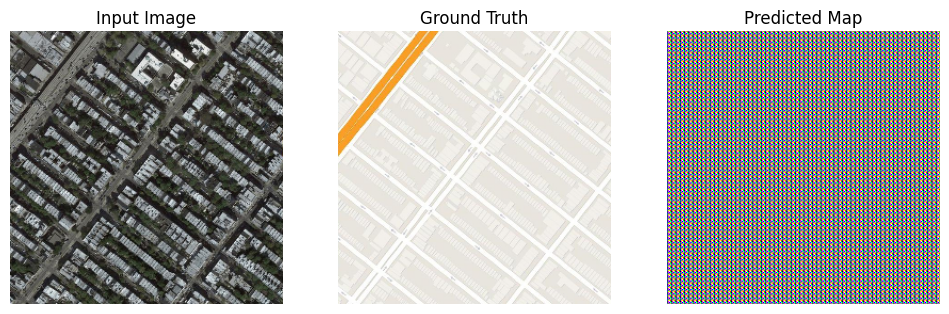

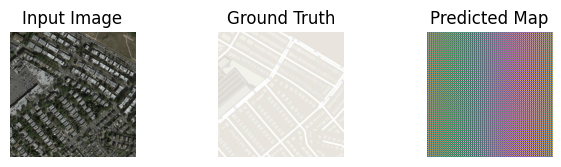

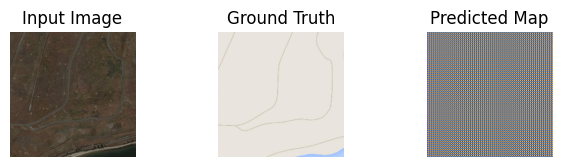

Batch 500/1096, D Real_Loss: 0.4442, D Fake_Loss: 0.4442 , G total_Loss: 4.6018
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
Batch 501/1096, D Real_Loss: 0.4442, D Fake_Loss: 0.4442 , G total_Loss: 4.6003
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
Batch 502/1096, D Real_Loss: 0.4442, D Fake_Loss: 0.4442 , G total_Loss: 4.5988
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Batch 503/1096, D Real_Loss: 0.4442, D Fake_Loss: 0.4443 , G total_Loss: 4.5974
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 504/1096, D Real_Loss: 0.4442, D Fake_Loss: 0.4443 , G total_Loss: 4.5959
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Batch 505/1096, D Real_Loss: 0.4442, D Fake_Loss: 0.4443 , G total_Loss: 4.5944
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Batch 506/1096, D Real_Loss: 0.4442, D Fake_Loss: 0.4443 , G total_Loss: 4.5929
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 507/1096, D Real_Loss: 0.4442, D Fake_Loss: 0.4443 , G total_Loss: 4.5915
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
Batch 508/1096, D Real_Loss: 0.4442, D Fake_Loss: 0.4443

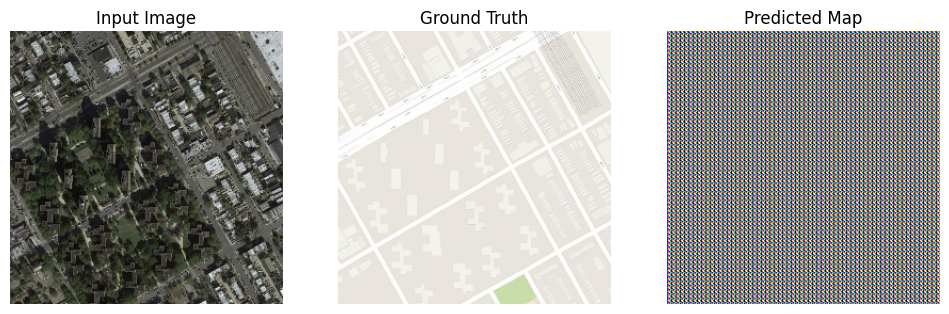

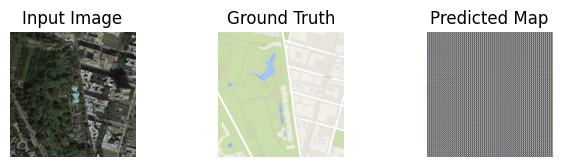

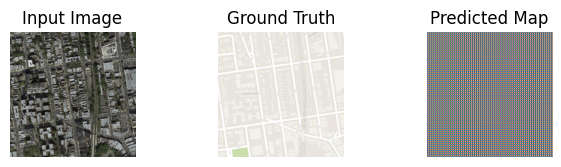

Batch 1000/1096, D Real_Loss: 0.4465, D Fake_Loss: 0.4466 , G total_Loss: 3.9592
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 1001/1096, D Real_Loss: 0.4465, D Fake_Loss: 0.4466 , G total_Loss: 3.9581
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Batch 1002/1096, D Real_Loss: 0.4465, D Fake_Loss: 0.4466 , G total_Loss: 3.9570
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 1003/1096, D Real_Loss: 0.4465, D Fake_Loss: 0.4466 , G total_Loss: 3.9560
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
Batch 1004/1096, D Real_Loss: 0.4465, D Fake_Loss: 0.4466 , G total_Loss: 3.9549
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 1005/1096, D Real_Loss: 0.4465, D Fake_Loss: 0.4466 , G total_Loss: 3.9538
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 1006/1096, D Real_Loss: 0.4465, D Fake_Loss: 0.4466 , G total_Loss: 3.9527
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 1007/1096, D Real_Loss: 0.4465, D Fake_Loss: 0.4466 , G total_Loss: 3.9516
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 1008/1096, D Real_Loss: 0.4465, D Fake_Los

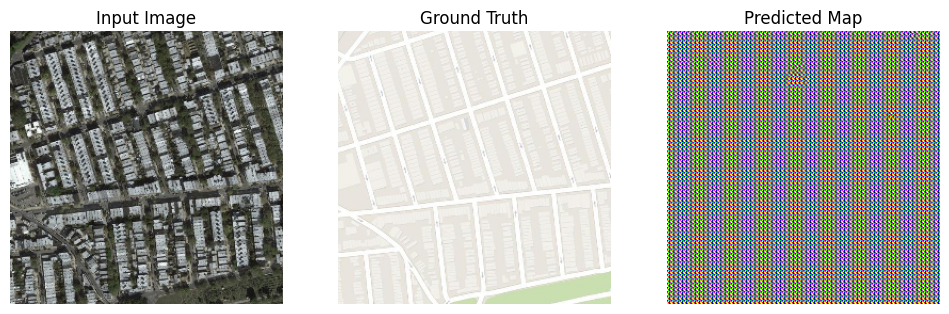

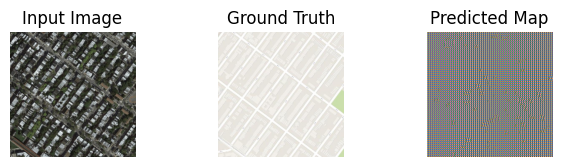

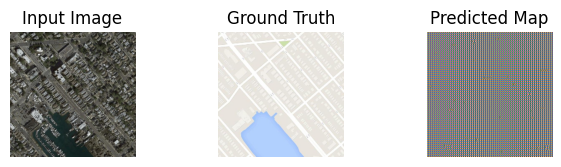

Batch 500/1096, D Real_Loss: 0.4483, D Fake_Loss: 0.4483 , G total_Loss: 3.5040
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Batch 501/1096, D Real_Loss: 0.4483, D Fake_Loss: 0.4483 , G total_Loss: 3.5032
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Batch 502/1096, D Real_Loss: 0.4483, D Fake_Loss: 0.4483 , G total_Loss: 3.5025
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Batch 503/1096, D Real_Loss: 0.4483, D Fake_Loss: 0.4483 , G total_Loss: 3.5027
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Batch 504/1096, D Real_Loss: 0.4483, D Fake_Loss: 0.4483 , G total_Loss: 3.5018
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Batch 505/1096, D Real_Loss: 0.4483, D Fake_Loss: 0.4483 , G total_Loss: 3.5011
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Batch 506/1096, D Real_Loss: 0.4483, D Fake_Loss: 0.4483 , G total_Loss: 3.5004
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 507/1096, D Real_Loss: 0.4483, D Fake_Loss: 0.4483 , G total_Loss: 3.4996
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Batch 508/1096, D Real_Loss: 0.4483, D Fake_Loss: 0.4483

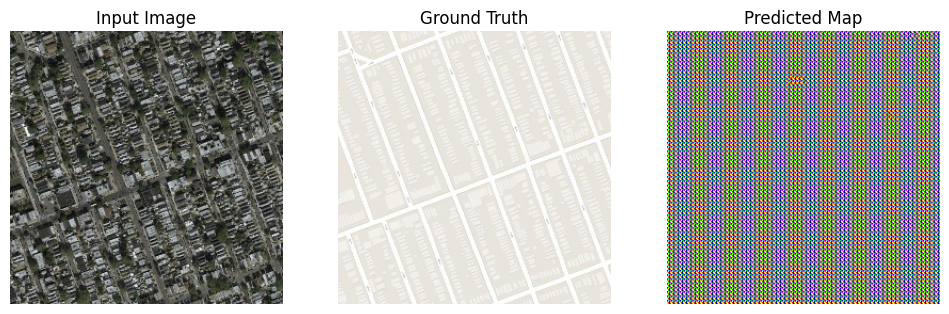

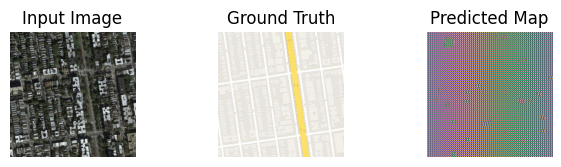

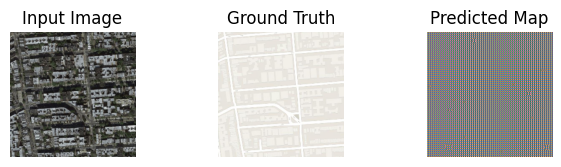

Batch 1000/1096, D Real_Loss: 0.4497, D Fake_Loss: 0.4497 , G total_Loss: 3.2835
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Batch 1001/1096, D Real_Loss: 0.4497, D Fake_Loss: 0.4497 , G total_Loss: 3.2830
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Batch 1002/1096, D Real_Loss: 0.4497, D Fake_Loss: 0.4497 , G total_Loss: 3.2825
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 1003/1096, D Real_Loss: 0.4497, D Fake_Loss: 0.4497 , G total_Loss: 3.2819
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 1004/1096, D Real_Loss: 0.4497, D Fake_Loss: 0.4497 , G total_Loss: 3.2814
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Batch 1005/1096, D Real_Loss: 0.4497, D Fake_Loss: 0.4497 , G total_Loss: 3.2808
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Batch 1006/1096, D Real_Loss: 0.4497, D Fake_Loss: 0.4497 , G total_Loss: 3.2802
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 1007/1096, D Real_Loss: 0.4497, D Fake_Loss: 0.4497 , G total_Loss: 3.2796
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 1008/1096, D Real_Loss: 0.4497, D Fake_Los

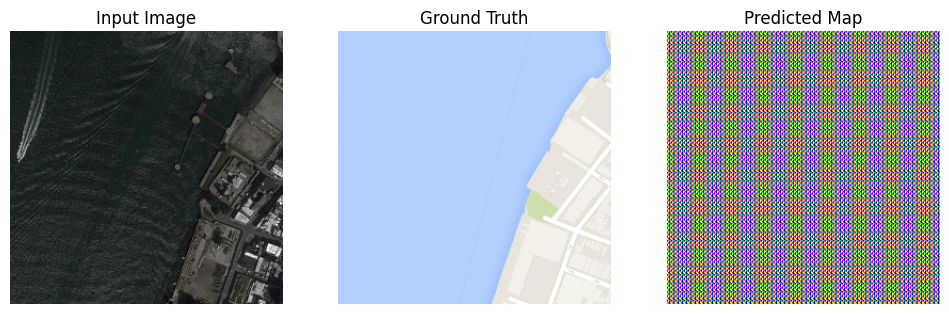

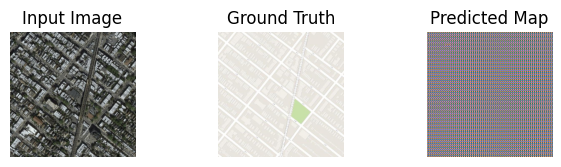

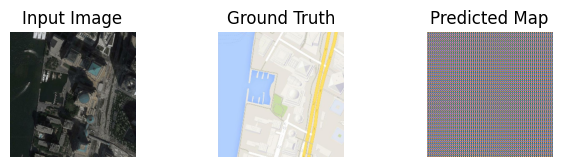

Batch 500/1096, D Real_Loss: 0.4510, D Fake_Loss: 0.4510 , G total_Loss: 3.3575
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Batch 501/1096, D Real_Loss: 0.4510, D Fake_Loss: 0.4510 , G total_Loss: 3.3569
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 502/1096, D Real_Loss: 0.4510, D Fake_Loss: 0.4510 , G total_Loss: 3.3563
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
Batch 503/1096, D Real_Loss: 0.4510, D Fake_Loss: 0.4510 , G total_Loss: 3.3557
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 504/1096, D Real_Loss: 0.4510, D Fake_Loss: 0.4510 , G total_Loss: 3.3551
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
Batch 505/1096, D Real_Loss: 0.4510, D Fake_Loss: 0.4510 , G total_Loss: 3.3545
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
Batch 506/1096, D Real_Loss: 0.4510, D Fake_Loss: 0.4510 , G total_Loss: 3.3539
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
Batch 507/1096, D Real_Loss: 0.4510, D Fake_Loss: 0.4510 , G total_Loss: 3.3534
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
Batch 508/1096, D Real_Loss: 0.4510, D Fake_Loss: 0.451

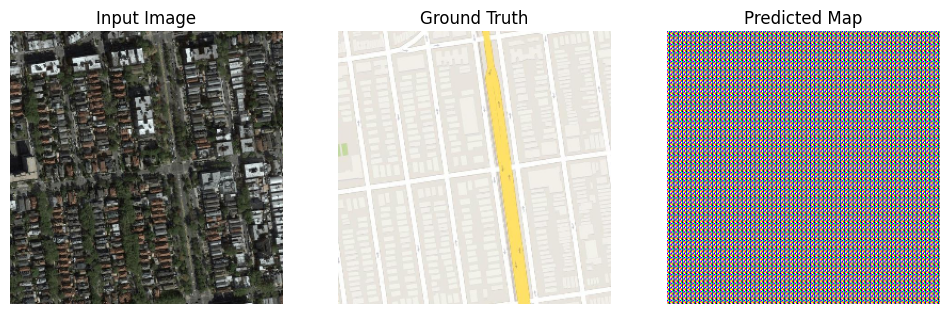

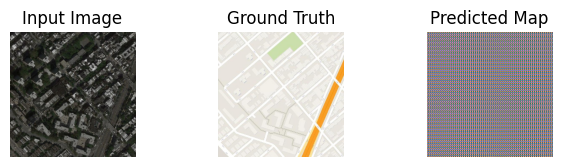

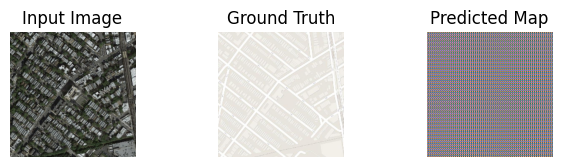

Batch 1000/1096, D Real_Loss: 0.4516, D Fake_Loss: 0.4516 , G total_Loss: 3.1079
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 1001/1096, D Real_Loss: 0.4516, D Fake_Loss: 0.4516 , G total_Loss: 3.1074
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
Batch 1002/1096, D Real_Loss: 0.4516, D Fake_Loss: 0.4516 , G total_Loss: 3.1069
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Batch 1003/1096, D Real_Loss: 0.4516, D Fake_Loss: 0.4516 , G total_Loss: 3.1064
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
Batch 1004/1096, D Real_Loss: 0.4516, D Fake_Loss: 0.4516 , G total_Loss: 3.1059
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
Batch 1005/1096, D Real_Loss: 0.4516, D Fake_Loss: 0.4516 , G total_Loss: 3.1054
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 1006/1096, D Real_Loss: 0.4516, D Fake_Loss: 0.4516 , G total_Loss: 3.1049
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
Batch 1007/1096, D Real_Loss: 0.4516, D Fake_Loss: 0.4516 , G total_Loss: 3.1044
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
Batch 1008/1096, D Real_Loss: 0.4516, D Fake_Lo

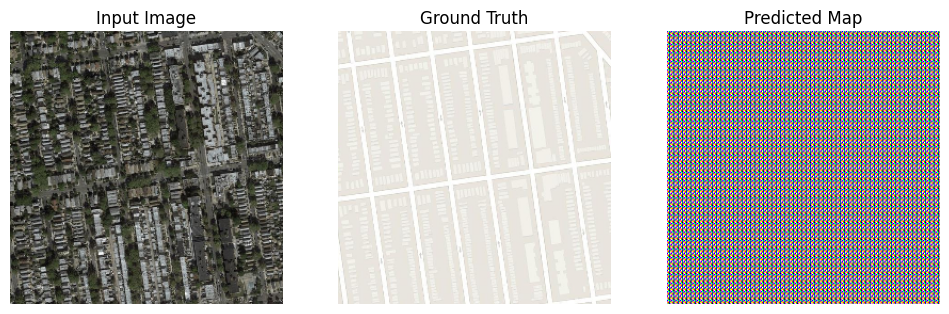

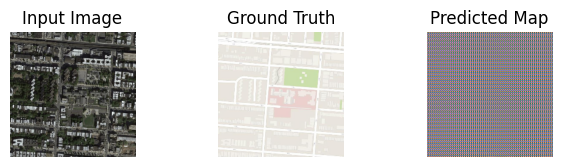

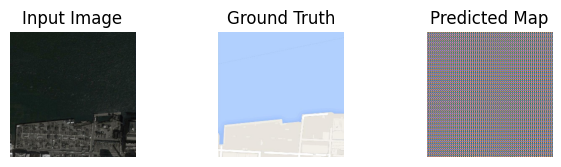

Batch 500/1096, D Real_Loss: 0.4517, D Fake_Loss: 0.4517 , G total_Loss: 2.8322
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Batch 501/1096, D Real_Loss: 0.4517, D Fake_Loss: 0.4517 , G total_Loss: 2.8317
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
Batch 502/1096, D Real_Loss: 0.4517, D Fake_Loss: 0.4517 , G total_Loss: 2.8313
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Batch 503/1096, D Real_Loss: 0.4517, D Fake_Loss: 0.4517 , G total_Loss: 2.8309
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Batch 504/1096, D Real_Loss: 0.4517, D Fake_Loss: 0.4517 , G total_Loss: 2.8305
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Batch 505/1096, D Real_Loss: 0.4517, D Fake_Loss: 0.4517 , G total_Loss: 2.8301
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 506/1096, D Real_Loss: 0.4517, D Fake_Loss: 0.4517 , G total_Loss: 2.8297
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 507/1096, D Real_Loss: 0.4517, D Fake_Loss: 0.4517 , G total_Loss: 2.8292
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 508/1096, D Real_Loss: 0.4517, D Fake_Loss: 0.4517

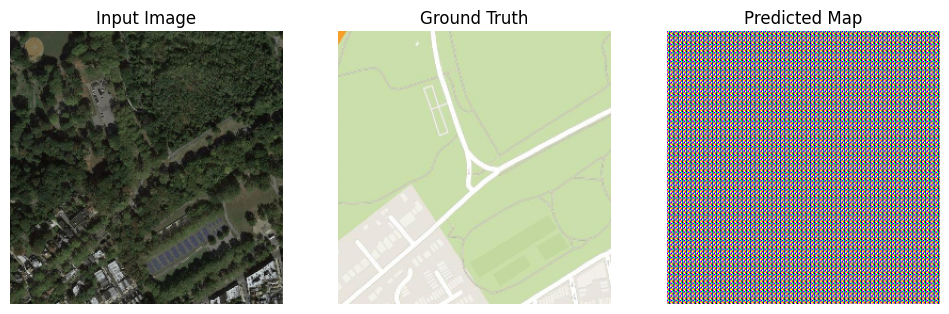

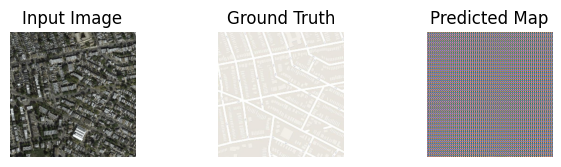

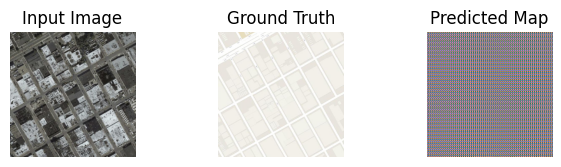

Batch 1000/1096, D Real_Loss: 0.4514, D Fake_Loss: 0.4514 , G total_Loss: 2.6393
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
Batch 1001/1096, D Real_Loss: 0.4514, D Fake_Loss: 0.4514 , G total_Loss: 2.6390
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
Batch 1002/1096, D Real_Loss: 0.4514, D Fake_Loss: 0.4514 , G total_Loss: 2.6386
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
Batch 1003/1096, D Real_Loss: 0.4514, D Fake_Loss: 0.4514 , G total_Loss: 2.6383
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
Batch 1004/1096, D Real_Loss: 0.4514, D Fake_Loss: 0.4514 , G total_Loss: 2.6379
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
Batch 1005/1096, D Real_Loss: 0.4514, D Fake_Loss: 0.4514 , G total_Loss: 2.6376
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
Batch 1006/1096, D Real_Loss: 0.4514, D Fake_Loss: 0.4514 , G total_Loss: 2.6372
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 1007/1096, D Real_Loss: 0.4514, D Fake_Loss: 0.4514 , G total_Loss: 2.6369
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
Batch 1008/1096, D Real_Loss: 0.4514, D Fake_

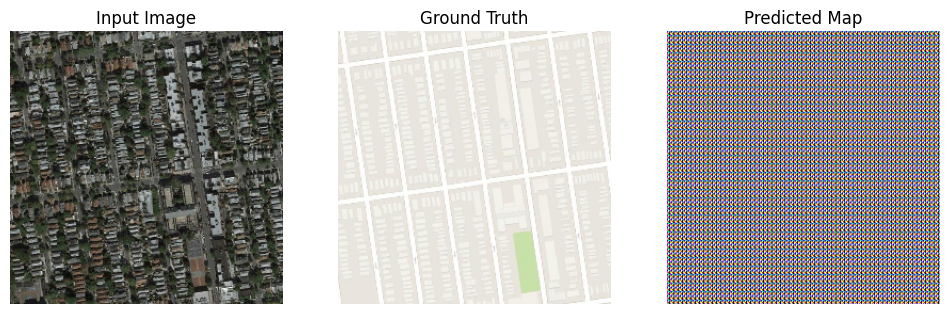

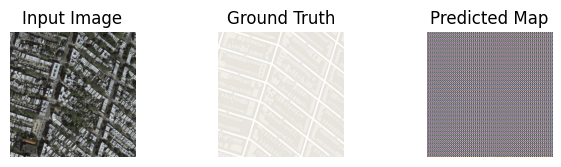

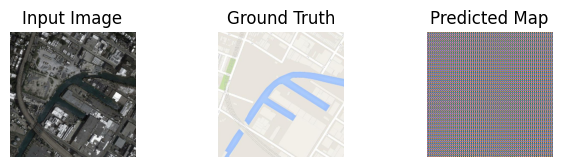

Batch 500/1096, D Real_Loss: 0.4507, D Fake_Loss: 0.4508 , G total_Loss: 2.4447
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 501/1096, D Real_Loss: 0.4507, D Fake_Loss: 0.4508 , G total_Loss: 2.4444
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 502/1096, D Real_Loss: 0.4507, D Fake_Loss: 0.4508 , G total_Loss: 2.4441
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Batch 503/1096, D Real_Loss: 0.4507, D Fake_Loss: 0.4507 , G total_Loss: 2.4438
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 504/1096, D Real_Loss: 0.4507, D Fake_Loss: 0.4507 , G total_Loss: 2.4435
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Batch 505/1096, D Real_Loss: 0.4507, D Fake_Loss: 0.4507 , G total_Loss: 2.4432
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 506/1096, D Real_Loss: 0.4507, D Fake_Loss: 0.4508 , G total_Loss: 2.4429
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 507/1096, D Real_Loss: 0.4507, D Fake_Loss: 0.4508 , G total_Loss: 2.4426
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Batch 508/1096, D Real_Loss: 0.4507, D Fake_Loss: 0.4507

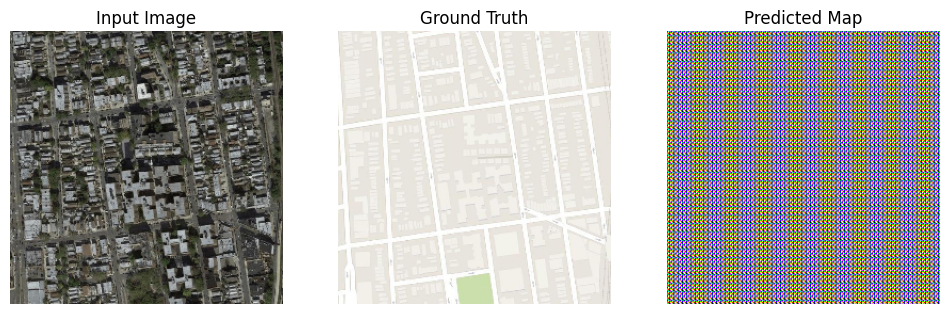

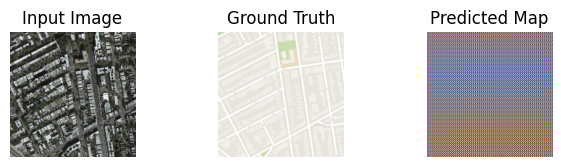

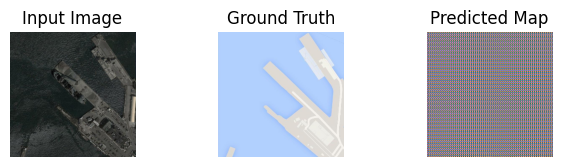

Batch 1000/1096, D Real_Loss: 0.4499, D Fake_Loss: 0.4500 , G total_Loss: 2.3052
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
Batch 1001/1096, D Real_Loss: 0.4499, D Fake_Loss: 0.4500 , G total_Loss: 2.3049
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 1002/1096, D Real_Loss: 0.4499, D Fake_Loss: 0.4499 , G total_Loss: 2.3046
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
Batch 1003/1096, D Real_Loss: 0.4499, D Fake_Loss: 0.4499 , G total_Loss: 2.3044
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 1004/1096, D Real_Loss: 0.4499, D Fake_Loss: 0.4499 , G total_Loss: 2.3041
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 1005/1096, D Real_Loss: 0.4499, D Fake_Loss: 0.4499 , G total_Loss: 2.3039
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Batch 1006/1096, D Real_Loss: 0.4499, D Fake_Loss: 0.4500 , G total_Loss: 2.3036
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 1007/1096, D Real_Loss: 0.4499, D Fake_Loss: 0.4500 , G total_Loss: 2.3033
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Batch 1008/1096, D Real_Loss: 0.4499, D Fake_Los

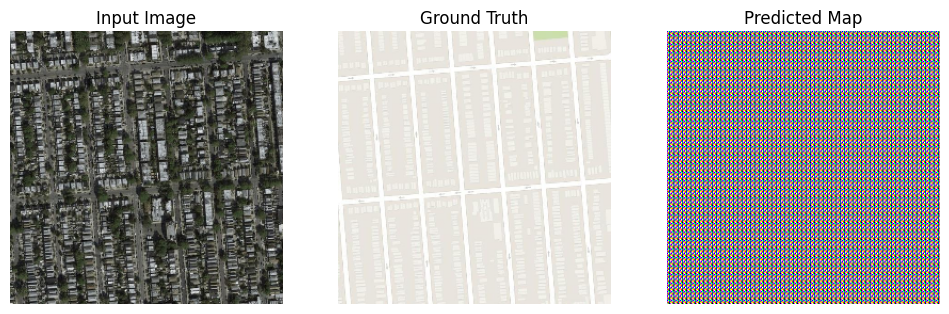

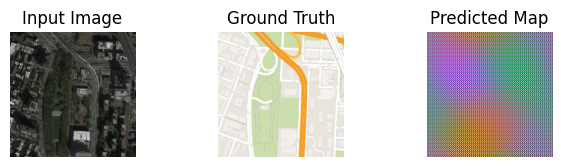

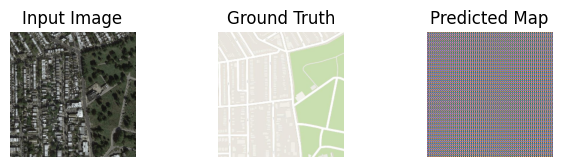

Batch 500/1096, D Real_Loss: 0.4487, D Fake_Loss: 0.4487 , G total_Loss: 2.1615
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 501/1096, D Real_Loss: 0.4487, D Fake_Loss: 0.4487 , G total_Loss: 2.1613
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
Batch 502/1096, D Real_Loss: 0.4487, D Fake_Loss: 0.4487 , G total_Loss: 2.1611
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
Batch 503/1096, D Real_Loss: 0.4487, D Fake_Loss: 0.4487 , G total_Loss: 2.1609
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
Batch 504/1096, D Real_Loss: 0.4487, D Fake_Loss: 0.4487 , G total_Loss: 2.1606
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
Batch 505/1096, D Real_Loss: 0.4487, D Fake_Loss: 0.4487 , G total_Loss: 2.1604
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Batch 506/1096, D Real_Loss: 0.4487, D Fake_Loss: 0.4487 , G total_Loss: 2.1602
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
Batch 507/1096, D Real_Loss: 0.4486, D Fake_Loss: 0.4487 , G total_Loss: 2.1600
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
Batch 508/1096, D Real_Loss: 0.4486, D Fake_Loss: 0.4487

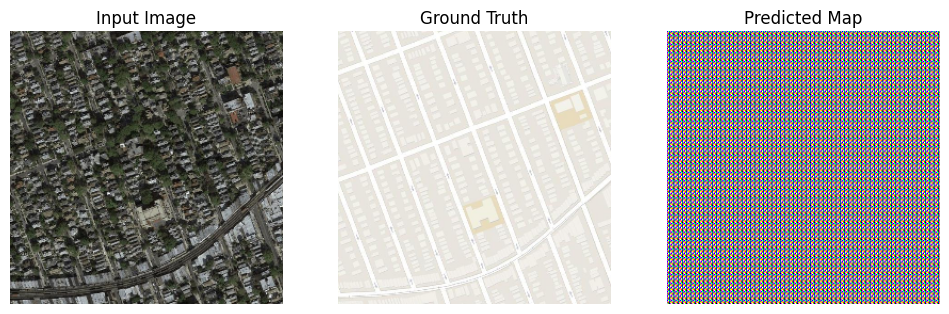

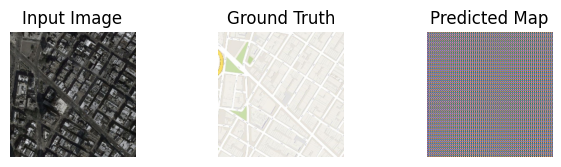

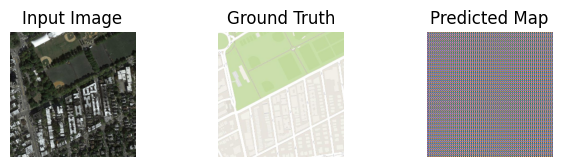

Batch 1000/1096, D Real_Loss: 0.4474, D Fake_Loss: 0.4474 , G total_Loss: 2.0567
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
Batch 1001/1096, D Real_Loss: 0.4474, D Fake_Loss: 0.4474 , G total_Loss: 2.0565
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
Batch 1002/1096, D Real_Loss: 0.4474, D Fake_Loss: 0.4474 , G total_Loss: 2.0563
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Batch 1003/1096, D Real_Loss: 0.4474, D Fake_Loss: 0.4474 , G total_Loss: 2.0561
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Batch 1004/1096, D Real_Loss: 0.4474, D Fake_Loss: 0.4474 , G total_Loss: 2.0559
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Batch 1005/1096, D Real_Loss: 0.4474, D Fake_Loss: 0.4474 , G total_Loss: 2.0558
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 1006/1096, D Real_Loss: 0.4474, D Fake_Loss: 0.4474 , G total_Loss: 2.0556
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 1007/1096, D Real_Loss: 0.4474, D Fake_Loss: 0.4474 , G total_Loss: 2.0554
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 1008/1096, D Real_Loss: 0.4474, D Fake_Los

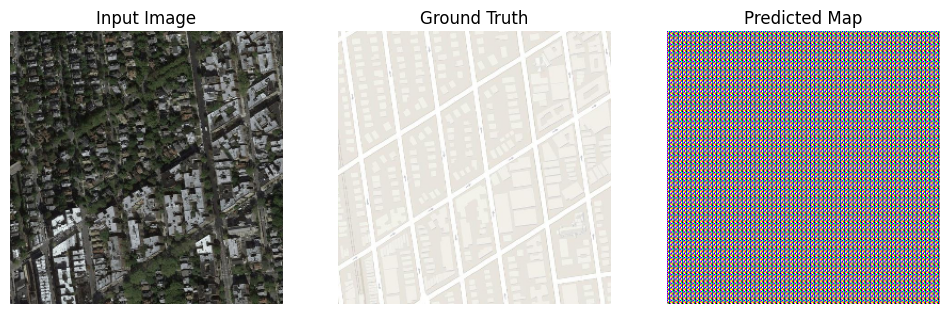

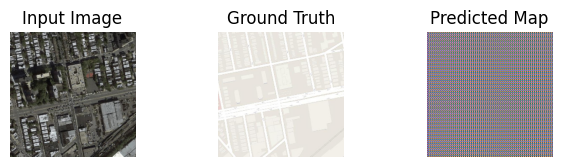

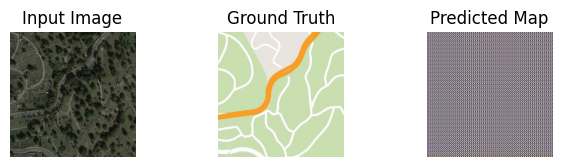

Batch 500/1096, D Real_Loss: 0.4457, D Fake_Loss: 0.4457 , G total_Loss: 1.9464
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 501/1096, D Real_Loss: 0.4457, D Fake_Loss: 0.4457 , G total_Loss: 1.9463
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
Batch 502/1096, D Real_Loss: 0.4457, D Fake_Loss: 0.4457 , G total_Loss: 1.9461
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
Batch 503/1096, D Real_Loss: 0.4457, D Fake_Loss: 0.4457 , G total_Loss: 1.9459
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
Batch 504/1096, D Real_Loss: 0.4457, D Fake_Loss: 0.4457 , G total_Loss: 1.9458
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
Batch 505/1096, D Real_Loss: 0.4457, D Fake_Loss: 0.4457 , G total_Loss: 1.9456
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
Batch 506/1096, D Real_Loss: 0.4457, D Fake_Loss: 0.4457 , G total_Loss: 1.9454
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
Batch 507/1096, D Real_Loss: 0.4457, D Fake_Loss: 0.4457 , G total_Loss: 1.9452
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
Batch 508/1096, D Real_Loss: 0.4457, D Fake_Loss: 0.445

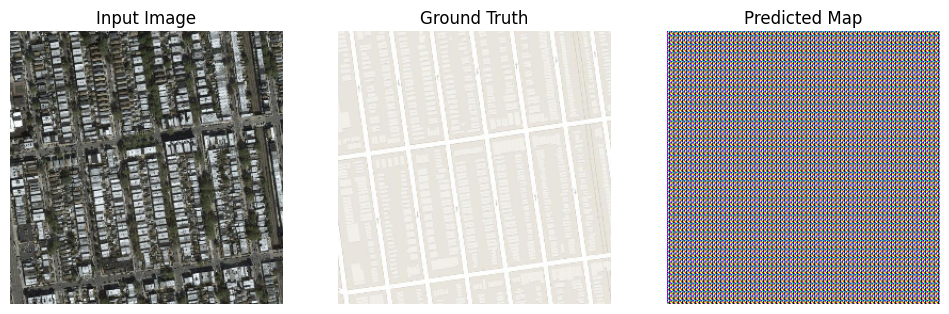

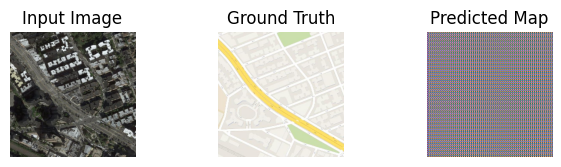

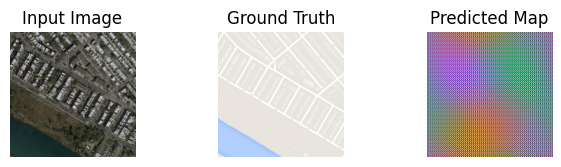

Batch 1000/1096, D Real_Loss: 0.4442, D Fake_Loss: 0.4442 , G total_Loss: 1.8643
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
Batch 1001/1096, D Real_Loss: 0.4442, D Fake_Loss: 0.4442 , G total_Loss: 1.8642
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
Batch 1002/1096, D Real_Loss: 0.4442, D Fake_Loss: 0.4442 , G total_Loss: 1.8640
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
Batch 1003/1096, D Real_Loss: 0.4441, D Fake_Loss: 0.4442 , G total_Loss: 1.8639
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
Batch 1004/1096, D Real_Loss: 0.4441, D Fake_Loss: 0.4442 , G total_Loss: 1.8637
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 1005/1096, D Real_Loss: 0.4441, D Fake_Loss: 0.4442 , G total_Loss: 1.8635
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 1006/1096, D Real_Loss: 0.4441, D Fake_Loss: 0.4441 , G total_Loss: 1.8634
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
Batch 1007/1096, D Real_Loss: 0.4441, D Fake_Loss: 0.4441 , G total_Loss: 1.8633
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
Batch 1008/1096, D Real_Loss: 0.4441, D Fake_Lo

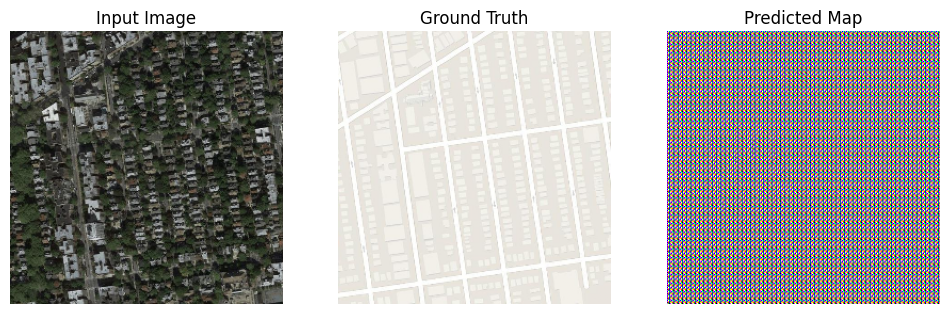

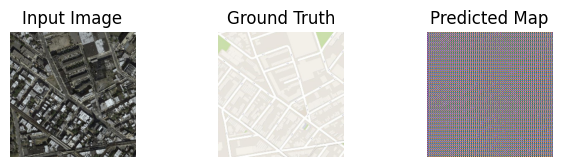

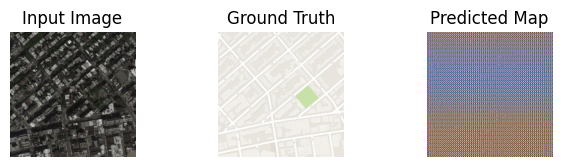

Batch 500/1096, D Real_Loss: 0.4421, D Fake_Loss: 0.4421 , G total_Loss: 1.7792
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
Batch 501/1096, D Real_Loss: 0.4421, D Fake_Loss: 0.4421 , G total_Loss: 1.7791
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 502/1096, D Real_Loss: 0.4421, D Fake_Loss: 0.4421 , G total_Loss: 1.7790
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 503/1096, D Real_Loss: 0.4421, D Fake_Loss: 0.4421 , G total_Loss: 1.7789
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
Batch 504/1096, D Real_Loss: 0.4421, D Fake_Loss: 0.4421 , G total_Loss: 1.7788
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
Batch 505/1096, D Real_Loss: 0.4421, D Fake_Loss: 0.4421 , G total_Loss: 1.7788
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
Batch 506/1096, D Real_Loss: 0.4421, D Fake_Loss: 0.4421 , G total_Loss: 1.7788
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
Batch 507/1096, D Real_Loss: 0.4421, D Fake_Loss: 0.4421 , G total_Loss: 1.7787
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
Batch 508/1096, D Real_Loss: 0.4421, D Fake_Loss: 0.4421

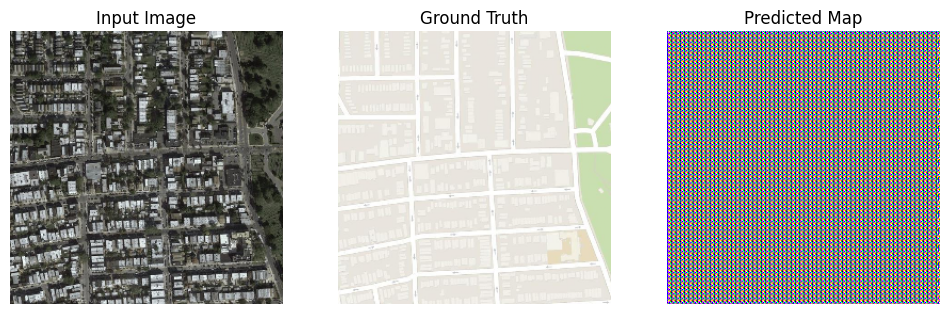

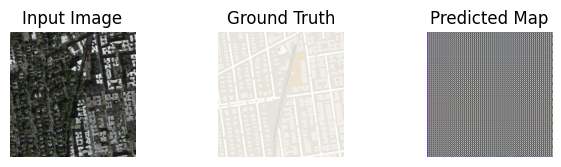

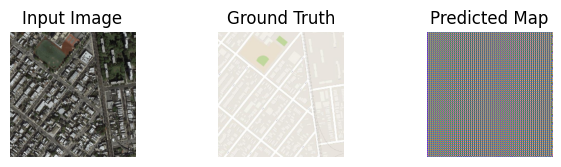

Batch 1000/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4411 , G total_Loss: 1.7371
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
Batch 1001/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4411 , G total_Loss: 1.7371
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 1002/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4411 , G total_Loss: 1.7369
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 1003/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4411 , G total_Loss: 1.7368
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
Batch 1004/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4411 , G total_Loss: 1.7367
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Batch 1005/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4411 , G total_Loss: 1.7366
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 1006/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4411 , G total_Loss: 1.7365
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Batch 1007/1096, D Real_Loss: 0.4411, D Fake_Loss: 0.4411 , G total_Loss: 1.7364
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Batch 1008/1096, D Real_Loss: 0.4411, D Fake_Los

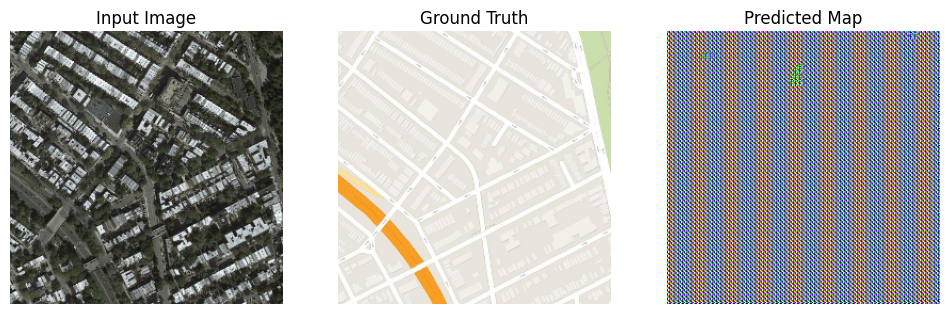

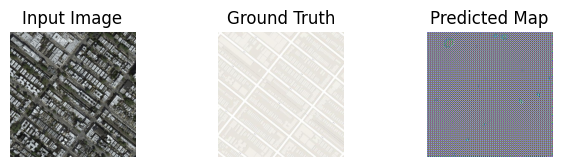

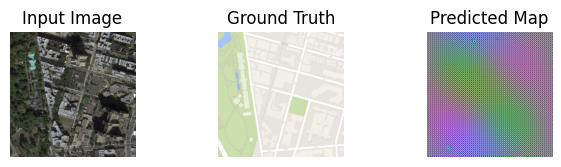

Batch 500/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6987
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 501/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6987
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 502/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6986
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Batch 503/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6985
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 504/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6985
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Batch 505/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6984
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 506/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6983
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 507/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6982
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 508/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404

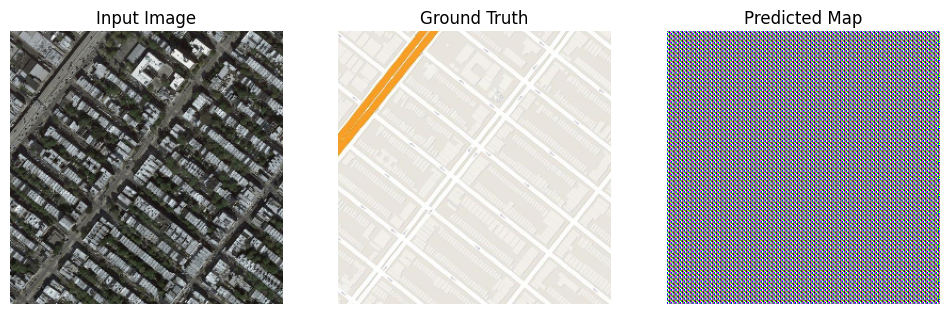

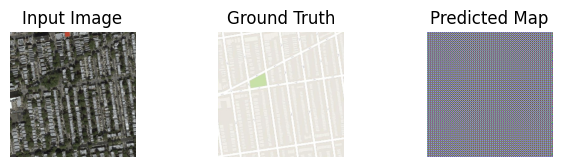

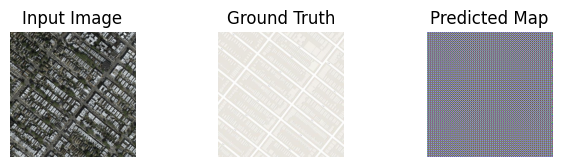

Batch 1000/1096, D Real_Loss: 0.4406, D Fake_Loss: 0.4406 , G total_Loss: 1.7282
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 1001/1096, D Real_Loss: 0.4406, D Fake_Loss: 0.4406 , G total_Loss: 1.7281
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Batch 1002/1096, D Real_Loss: 0.4406, D Fake_Loss: 0.4406 , G total_Loss: 1.7279
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
Batch 1003/1096, D Real_Loss: 0.4406, D Fake_Loss: 0.4406 , G total_Loss: 1.7278
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Batch 1004/1096, D Real_Loss: 0.4406, D Fake_Loss: 0.4406 , G total_Loss: 1.7277
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 1005/1096, D Real_Loss: 0.4406, D Fake_Loss: 0.4406 , G total_Loss: 1.7276
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Batch 1006/1096, D Real_Loss: 0.4406, D Fake_Loss: 0.4406 , G total_Loss: 1.7275
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
Batch 1007/1096, D Real_Loss: 0.4406, D Fake_Loss: 0.4406 , G total_Loss: 1.7274
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 1008/1096, D Real_Loss: 0.4406, D Fake_Los

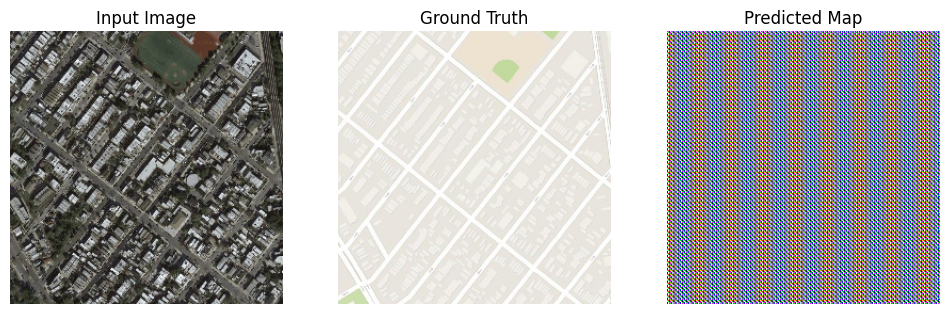

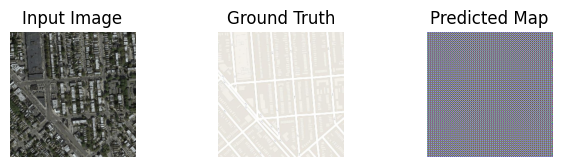

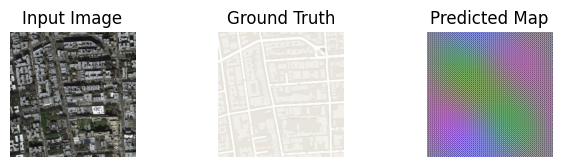

Batch 500/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6634
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 501/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6633
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
Batch 502/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6632
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 503/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6631
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Batch 504/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6630
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 505/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6629
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Batch 506/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6628
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 507/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404 , G total_Loss: 1.6627
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Batch 508/1096, D Real_Loss: 0.4404, D Fake_Loss: 0.4404

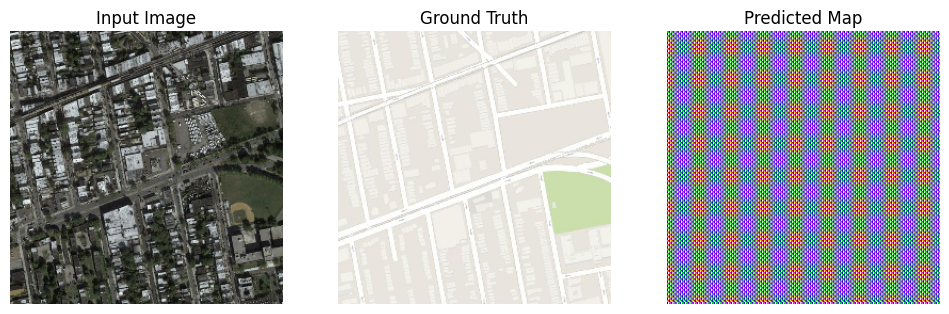

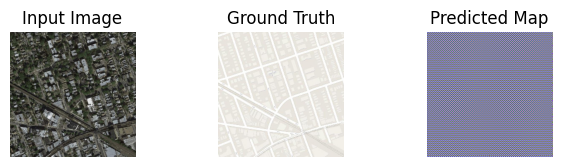

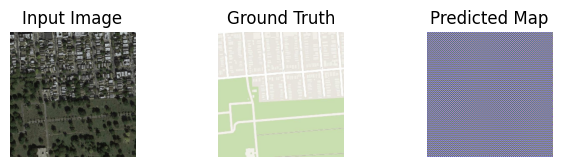

Batch 1000/1096, D Real_Loss: 0.4401, D Fake_Loss: 0.4401 , G total_Loss: 1.6607
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Batch 1001/1096, D Real_Loss: 0.4401, D Fake_Loss: 0.4401 , G total_Loss: 1.6606
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
Batch 1002/1096, D Real_Loss: 0.4401, D Fake_Loss: 0.4401 , G total_Loss: 1.6605
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 1003/1096, D Real_Loss: 0.4401, D Fake_Loss: 0.4401 , G total_Loss: 1.6604
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
Batch 1004/1096, D Real_Loss: 0.4401, D Fake_Loss: 0.4401 , G total_Loss: 1.6603
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
Batch 1005/1096, D Real_Loss: 0.4401, D Fake_Loss: 0.4401 , G total_Loss: 1.6602
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
Batch 1006/1096, D Real_Loss: 0.4401, D Fake_Loss: 0.4401 , G total_Loss: 1.6601
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
Batch 1007/1096, D Real_Loss: 0.4401, D Fake_Loss: 0.4401 , G total_Loss: 1.6600
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
Batch 1008/1096, D Real_Loss: 0.4401, D Fake_L

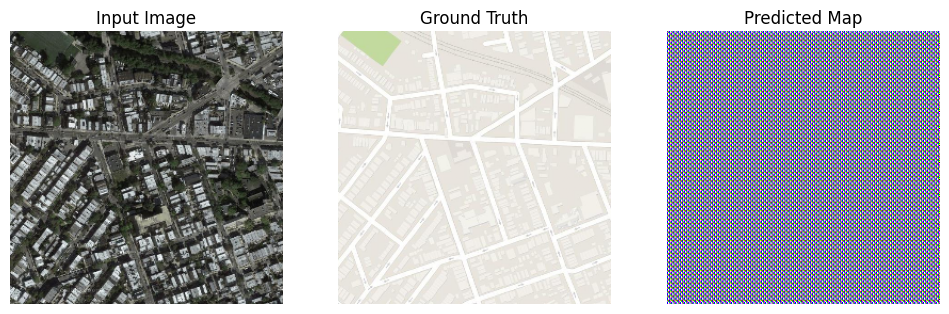

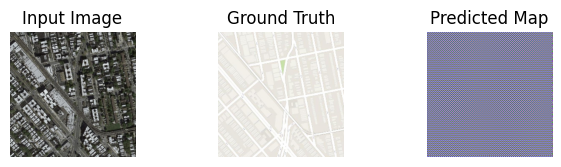

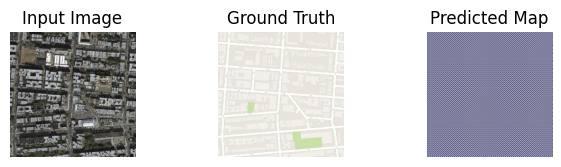

Batch 500/1096, D Real_Loss: 0.4395, D Fake_Loss: 0.4395 , G total_Loss: 1.6032
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Batch 501/1096, D Real_Loss: 0.4395, D Fake_Loss: 0.4395 , G total_Loss: 1.6031
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 502/1096, D Real_Loss: 0.4395, D Fake_Loss: 0.4395 , G total_Loss: 1.6030
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 503/1096, D Real_Loss: 0.4395, D Fake_Loss: 0.4395 , G total_Loss: 1.6029
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 504/1096, D Real_Loss: 0.4395, D Fake_Loss: 0.4395 , G total_Loss: 1.6028
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
Batch 505/1096, D Real_Loss: 0.4395, D Fake_Loss: 0.4395 , G total_Loss: 1.6027
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Batch 506/1096, D Real_Loss: 0.4395, D Fake_Loss: 0.4395 , G total_Loss: 1.6026
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
Batch 507/1096, D Real_Loss: 0.4395, D Fake_Loss: 0.4395 , G total_Loss: 1.6026
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Batch 508/1096, D Real_Loss: 0.4395, D Fake_Loss: 0.4395

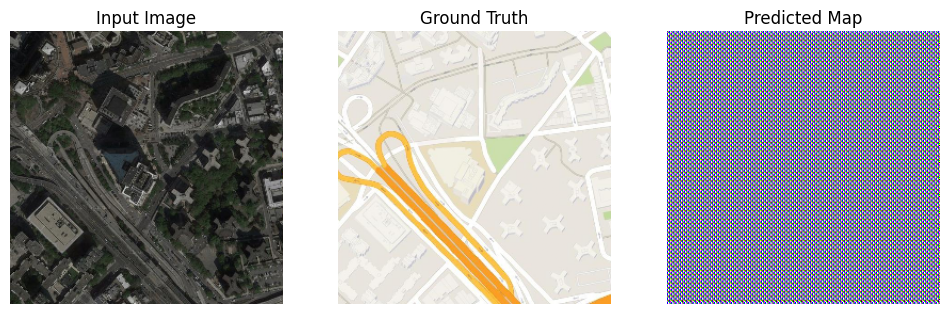

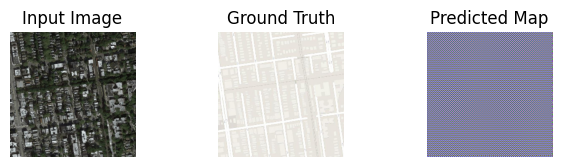

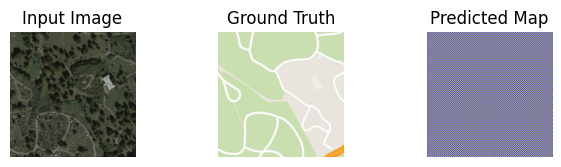

Batch 1000/1096, D Real_Loss: 0.4388, D Fake_Loss: 0.4388 , G total_Loss: 1.5585
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Batch 1001/1096, D Real_Loss: 0.4388, D Fake_Loss: 0.4388 , G total_Loss: 1.5584
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
Batch 1002/1096, D Real_Loss: 0.4388, D Fake_Loss: 0.4388 , G total_Loss: 1.5583
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
Batch 1003/1096, D Real_Loss: 0.4388, D Fake_Loss: 0.4388 , G total_Loss: 1.5582
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
Batch 1004/1096, D Real_Loss: 0.4388, D Fake_Loss: 0.4388 , G total_Loss: 1.5581
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
Batch 1005/1096, D Real_Loss: 0.4388, D Fake_Loss: 0.4388 , G total_Loss: 1.5580
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
Batch 1006/1096, D Real_Loss: 0.4388, D Fake_Loss: 0.4388 , G total_Loss: 1.5579
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
Batch 1007/1096, D Real_Loss: 0.4388, D Fake_Loss: 0.4388 , G total_Loss: 1.5579
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Batch 1008/1096, D Real_Loss: 0.4388, D Fake_L

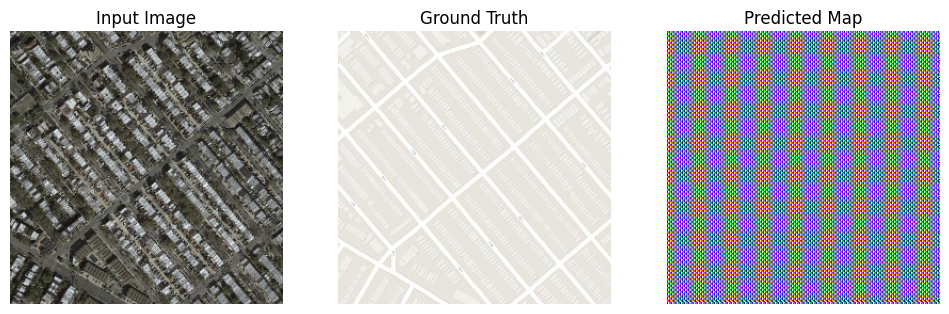

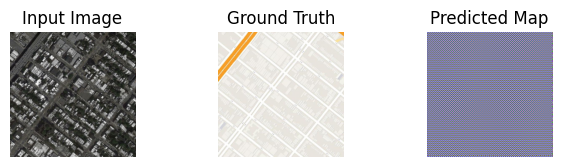

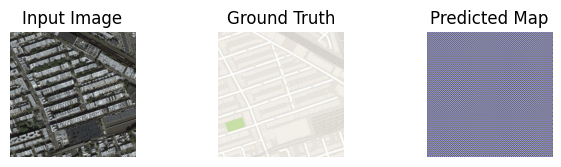

Batch 500/1096, D Real_Loss: 0.4378, D Fake_Loss: 0.4378 , G total_Loss: 1.5092
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
Batch 501/1096, D Real_Loss: 0.4378, D Fake_Loss: 0.4378 , G total_Loss: 1.5091
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 502/1096, D Real_Loss: 0.4378, D Fake_Loss: 0.4378 , G total_Loss: 1.5090
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 503/1096, D Real_Loss: 0.4378, D Fake_Loss: 0.4378 , G total_Loss: 1.5090
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Batch 504/1096, D Real_Loss: 0.4378, D Fake_Loss: 0.4378 , G total_Loss: 1.5089
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
Batch 505/1096, D Real_Loss: 0.4378, D Fake_Loss: 0.4378 , G total_Loss: 1.5088
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 506/1096, D Real_Loss: 0.4378, D Fake_Loss: 0.4378 , G total_Loss: 1.5087
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Batch 507/1096, D Real_Loss: 0.4378, D Fake_Loss: 0.4378 , G total_Loss: 1.5087
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
Batch 508/1096, D Real_Loss: 0.4377, D Fake_Loss: 0.4378

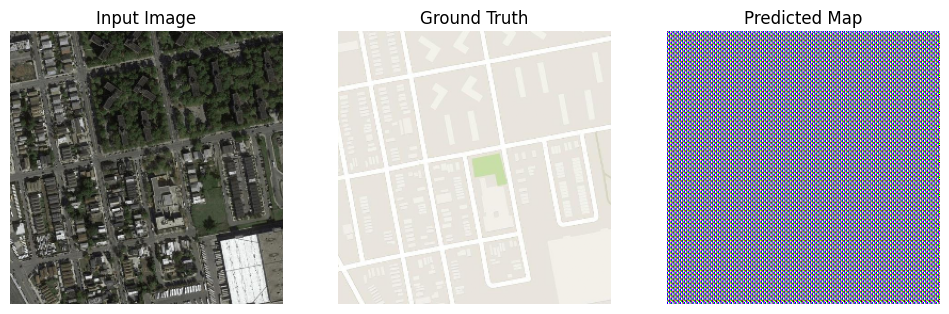

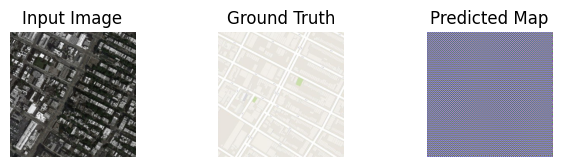

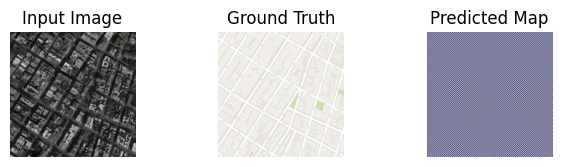

Batch 1000/1096, D Real_Loss: 0.4367, D Fake_Loss: 0.4367 , G total_Loss: 1.4711
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 1001/1096, D Real_Loss: 0.4367, D Fake_Loss: 0.4367 , G total_Loss: 1.4710
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 1002/1096, D Real_Loss: 0.4367, D Fake_Loss: 0.4367 , G total_Loss: 1.4710
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 1003/1096, D Real_Loss: 0.4367, D Fake_Loss: 0.4367 , G total_Loss: 1.4709
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Batch 1004/1096, D Real_Loss: 0.4367, D Fake_Loss: 0.4367 , G total_Loss: 1.4708
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Batch 1005/1096, D Real_Loss: 0.4367, D Fake_Loss: 0.4367 , G total_Loss: 1.4708
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
Batch 1006/1096, D Real_Loss: 0.4366, D Fake_Loss: 0.4367 , G total_Loss: 1.4707
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
Batch 1007/1096, D Real_Loss: 0.4366, D Fake_Loss: 0.4367 , G total_Loss: 1.4706
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
Batch 1008/1096, D Real_Loss: 0.4366, D Fake_Los

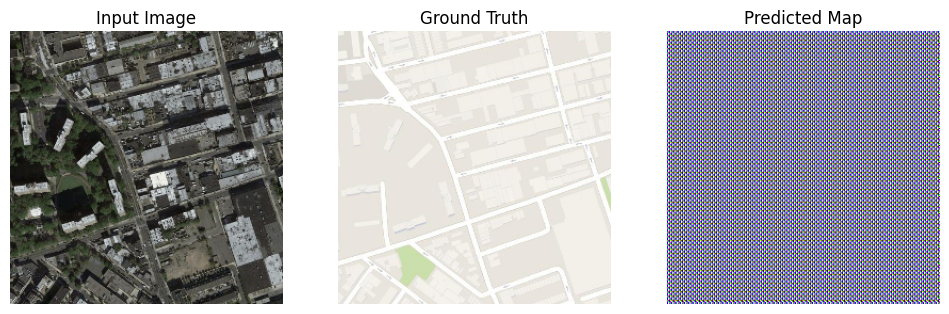

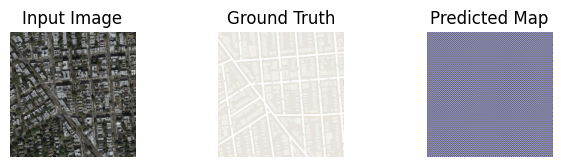

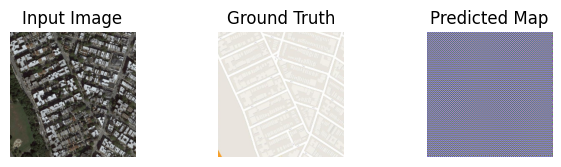

Batch 500/1096, D Real_Loss: 0.4352, D Fake_Loss: 0.4353 , G total_Loss: 1.4291
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
Batch 501/1096, D Real_Loss: 0.4352, D Fake_Loss: 0.4353 , G total_Loss: 1.4291
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
Batch 502/1096, D Real_Loss: 0.4352, D Fake_Loss: 0.4353 , G total_Loss: 1.4290
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
Batch 503/1096, D Real_Loss: 0.4352, D Fake_Loss: 0.4353 , G total_Loss: 1.4289
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Batch 504/1096, D Real_Loss: 0.4352, D Fake_Loss: 0.4352 , G total_Loss: 1.4289
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
Batch 505/1096, D Real_Loss: 0.4352, D Fake_Loss: 0.4352 , G total_Loss: 1.4288
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
Batch 506/1096, D Real_Loss: 0.4352, D Fake_Loss: 0.4352 , G total_Loss: 1.4287
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
Batch 507/1096, D Real_Loss: 0.4352, D Fake_Loss: 0.4352 , G total_Loss: 1.4287
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
Batch 508/1096, D Real_Loss: 0.4352, D Fake_Loss: 0.43

In [ ]:
# Train the model
train_on_batch(generator_model, discriminator_model, gan_model, sat_train, maps_train, val_sat,val_map)

In [25]:

def validate_generator(trained_generator_model, satellite_images_test, map_images_test, num_samples=5, output_dir=generated_images_dir):
    """
    Validates the trained generator model on a set of test images.

    Args:
        trained_generator_model (keras.Model): The trained generator model.
        satellite_images_test (np.ndarray): Array of satellite test images.
        map_images_test (np.ndarray): Array of map test images.
        num_samples (int): The number of test images to use for validation.
        output_dir (str): Directory to save the validation images.
    """


    # Select a random subset of test images
    idx = np.random.choice(len(satellite_images_test), num_samples, replace=False)
    sample_sat_test = satellite_images_test[idx]
    sample_target_test = map_images_test[idx]

    # Generate maps using the generator model
    sample_generated_map = trained_generator_model.predict(sample_sat_test)

    # Scale pixels from [-1, 1] to [0, 1] for visualization
    sample_sat_test = (sample_sat_test + 1) / 2.0
    sample_target_test = (sample_target_test + 1) / 2.0
    sample_generated_map = (sample_generated_map + 1) / 2.0

    title = ['Input Satellite Image', 'Ground Truth Map', 'Generated Map']
    plt.figure(figsize=(10, num_samples * 3))

    for i in range(num_samples):
        # Display the input satellite image
        plt.subplot(num_samples, 3, i * 3 + 1)
        plt.imshow(sample_sat_test[i])
        plt.title(title[0])
        plt.axis('off')

        # Display the ground truth map
        plt.subplot(num_samples, 3, i * 3 + 2)
        plt.imshow(sample_target_test[i])
        plt.title(title[1])
        plt.axis('off')

        # Display the generated map
        plt.subplot(num_samples, 3, i * 3 + 3)
        plt.imshow(sample_generated_map[i])
        plt.title(title[2])
        plt.axis('off')

    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, 'validation_results.png'))
    plt.show()
    plt.close()



In [20]:

# Path to the directory containing saved models
models_direc = '/content/drive/MyDrive/Colab Notebooks/BME_Projects/map_data_gan/models_saved'

# Get the latest saved model file
list_of_files = os.listdir(models_direc)
# Filter only files with the .keras extension
keras_files = [f for f in list_of_files if f.endswith('.keras')]

if not keras_files:
    print("No .keras model files found in the specified directory.")
else:
    # Sort by modification time (most recent first)
    latest_file = max(keras_files, key=lambda x: os.path.getmtime(os.path.join(models_direc, x)))
    latest_model_path = os.path.join(models_direc, latest_file)

    # Load the generator model
    try:
        loaded_generator = tf.keras.models.load_model(latest_model_path, compile=False)
        print(f"Successfully loaded the generator model from: {latest_model_path}")

    except Exception as e:
        print(f"Error loading the model: {e}")



Successfully loaded the generator model from: /content/drive/MyDrive/Colab Notebooks/BME_Projects/map_data_gan/models_saved/generator_model_epoch39_batch999.keras


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


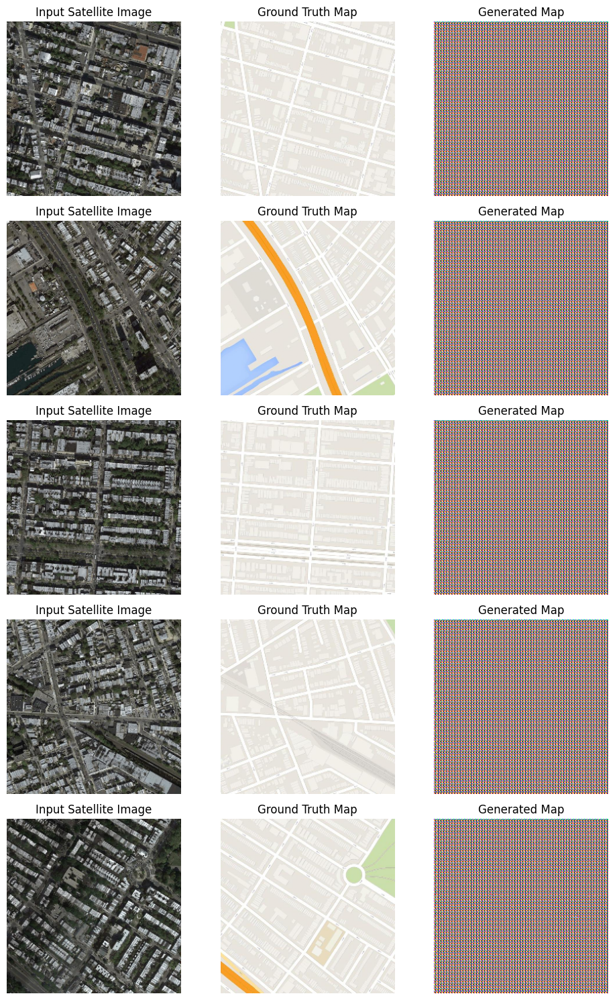

In [26]:
validate_generator(loaded_generator, val_sat, val_map, num_samples=5)